# Capstone Project - The Battle of the Neighborhoods
### Applied Data Science Capstone by IBM/Coursera

## Table of contents
* [Introduction: Business Problem](#introduction)
* [Data](#data)
* [Methodology](#methodology)
* [Analysis](#analysis)
* [Results and Discussion](#results)
* [Conclusion](#conclusion)



## Introduction: Business Problem <a name="introduction"></a>

In this project we will try to find an optimal location for a restaurant. Specifically, this report will be targeted to stakeholders interested in opening an **Italian restaurant** in **Toronto**, Canada.

Since there are lots of restaurants in Toronto we will try to detect **locations that are not already crowded with restaurants**. We are also particularly interested in **areas with no Italian restaurants in vicinity**. We would also prefer locations **as close to city center as possible**, assuming that first two conditions are met.

We will use our data science powers to generate a few most promissing neighborhoods based on this criteria. Advantages of each area will then be clearly expressed so that best possible final location can be chosen by stakeholders.

## Data <a name="data"></a>

Based on definition of our problem, factors that will influence our decission are:
* number of existing restaurants in the neighborhood (any type of restaurant)
* number of and distance to Italian restaurants in the neighborhood, if any
* distance of neighborhood from city center

We decided to use regularly spaced grid of locations, centered around city center, to define our neighborhoods.

Following data sources will be needed to extract/generate the required information:
* centers of candidate areas will be generated algorithmically  and approximate addresses of centers of those areas will be obtained using **geopy reverse API**
* number of restaurants and their type and location in every neighborhood will be obtained using **Foursquare API**
* coordinate of Toronto center will be obtained using **geopy API**
* borders of Toronto boroughs are calculated from **https://raw.githubusercontent.com/jasonicarter/toronto-geojson/master/toronto_crs84.geojson**

### Neighborhood Candidates

Let's create latitude & longitude coordinates for centroids of our candidate neighborhoods. We will create a grid of cells covering our area of interest which is aprox. 12x12 killometers centered around Toronto city center.

Let's first find the latitude & longitude of Toronto city center, using specific, well known address and geopy API. Let's assume Toronto center is Midtown bourgh

In [1]:
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

address = 'Midtown, Toronto'

geolocator = Nominatim(user_agent="tr_explorer")
location = geolocator.geocode(address)
toronto_latitude_center = location.latitude
toronto_longitude_center = location.longitude
print('The geograpical coordinate of Toronto are {}, {}.'.format(toronto_latitude_center, toronto_longitude_center))

The geograpical coordinate of Toronto are 43.7057358, -79.39756691740916.


Now let's create a grid of area candidates, equaly spaced, centered around city center and within ~6km from Toronto center. Our neighborhoods will be defined as circular areas with a radius of 300 meters, so our neighborhood centers will be 600 meters apart.

To accurately calculate distances we need to create our grid of locations in Cartesian 2D coordinate system which allows us to calculate distances in meters (not in latitude/longitude degrees). Then we'll project those coordinates back to latitude/longitude degrees to be shown on Folium map. So let's create functions to convert between WGS84 spherical coordinate system (latitude/longitude degrees) and UTM Cartesian coordinate system (X/Y coordinates in  meters).

In [5]:
!pip install shapely
!pip install pyproj

In [2]:
import pyproj

import math

def lonlat_to_xy(lon,lat):
    P = pyproj.Proj(proj='utm', zone=33, ellps='WGS84', preserve_units=True)
    return P(lon,lat)    

def xy_to_lonlat(x,y):
    P = pyproj.Proj(proj='utm', zone=33, ellps='WGS84', preserve_units=True)
    return P(x,y,inverse=True)    

def calc_xy_distance(x1, y1, x2, y2):
    dx = x2 - x1
    dy = y2 - y1
    return math.sqrt(dx*dx + dy*dy)

print('Coordinate transformation check')
print('-------------------------------')
print('Toronto center longitude={}, latitude={}'.format(toronto_longitude_center, toronto_latitude_center))
x, y = lonlat_to_xy(toronto_longitude_center, toronto_latitude_center)
print('Toronto center UTM X={}, Y={}'.format(x, y))
lo, la = xy_to_lonlat(x, y)
print('Toronto center longitude={}, latitude={}'.format(lo, la))

Coordinate transformation check
-------------------------------
Toronto center longitude=-79.39756691740916, latitude=43.7057358
Toronto center UTM X=-5302042.990274137, Y=10508191.441211358
Toronto center longitude=-79.39756691740965, latitude=43.705735799999765


Let's create a **hexagonal grid of cells**: we offset every other row, and adjust vertical row spacing so that **every cell center is equally distant from all it's neighbors**.

In [3]:
toronto_longitude_center_x, toronto_latitude_center_y = lonlat_to_xy(toronto_longitude_center, toronto_latitude_center) # City center in Cartesian coordinates

k = math.sqrt(3) / 2 # Vertical offset for hexagonal grid cells
x_min = toronto_longitude_center_x - 6000
x_step = 600
y_min = toronto_latitude_center_y - 6000 - (int(21/k)*k*600 - 12000)/2
y_step = 600 * k 

latitudes = []
longitudes = []
distances_from_center = []
xs = []
ys = []
for i in range(0, int(21/k)):
    y = y_min + i * y_step
    x_offset = 300 if i%2==0 else 0
    for j in range(0, 21):
        x = x_min + j * x_step + x_offset
        distance_from_center = calc_xy_distance(toronto_longitude_center_x, toronto_latitude_center_y, x, y)
        if (distance_from_center <= 6001):
            lon, lat = xy_to_lonlat(x, y)
            latitudes.append(lat)
            longitudes.append(lon)
            distances_from_center.append(distance_from_center)
            xs.append(x)
            ys.append(y)

print(len(latitudes), 'candidate neighborhood centers generated.')

364 candidate neighborhood centers generated.


Let's visualize the data we have so far: city center location and candidate neighborhood centers:

In [4]:
#!pip install folium

import folium


In [5]:
map_toronto = folium.Map(location=(toronto_latitude_center, toronto_longitude_center), zoom_start=13)
folium.Marker((toronto_latitude_center, toronto_longitude_center), popup='Center Toronto').add_to(map_toronto)
for lat, lon in zip(latitudes, longitudes):
    #folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_toronto) 
    folium.Circle([lat, lon], radius=300, color='blue', fill=False).add_to(map_toronto)
    #folium.Marker([lat, lon]).add_to(map_toronto)
map_toronto

OK, we now have the coordinates of centers of neighborhoods/areas to be evaluated, equally spaced (distance from every point to it's neighbors is exactly the same) and within ~6km from Toronto Center. 

Let's now use geopy API to get approximate addresses of those locations.

In [6]:
def get_address(latitude, longitude):
    try:
        location = geolocator.reverse([latitude, longitude], exactly_one=True)
        return location.raw['display_name']
    except:
        return None

addr = get_address(toronto_latitude_center, toronto_longitude_center)
print('Reverse geocoding check')
print('-----------------------')
print('Address of [{}, {}] is: {}'.format(toronto_latitude_center, toronto_longitude_center, addr))

Reverse geocoding check
-----------------------
Address of [43.7057358, -79.39756691740916] is: Minto Midtown - Quantum 2, Anne Johnston Courtyard, Yonge & Eglinton, Toronto—St. Paul's, Old Toronto, Toronto, Golden Horseshoe, Ontario, M4S 2B2, Canada


In [7]:
print('Obtaining location addresses: ', end='')
addresses = []
for lat, lon in zip(latitudes, longitudes):
    address = get_address(lat, lon)
    if address is None:
        address = 'NO ADDRESS'
    #address = address.replace(', Germany', '') # We don't need country part of address
    addresses.append(address)
    print(' .', end='')
print(' done.')

Obtaining location addresses:  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . done.


In [8]:
addresses[150:170]

["Rosedale Golf Club, Plymbridge Road, Hogg's Hollow, Don Valley West, North York, Toronto, Golden Horseshoe, Ontario, M4N 2N5, Canada",
 "Rosedale Golf Club, Plymbridge Road, Hogg's Hollow, Don Valley West, North York, Toronto, Golden Horseshoe, Ontario, M4N 2N5, Canada",
 '11, May Tree Road, York Mills, Don Valley West, North York, Toronto, Golden Horseshoe, Ontario, M2P 1G6, Canada',
 '3, Scollard Street, Yorkville, University—Rosedale, Old Toronto, Toronto, Golden Horseshoe, Ontario, M4W 0A4, Canada',
 'Rosedale Station, TTC Rosedale Bus Terminal, Yorkville, University—Rosedale, Old Toronto, Toronto, Golden Horseshoe, Ontario, Canada',
 '31, Price Street, Rosedale, University—Rosedale, Old Toronto, Toronto, Golden Horseshoe, Ontario, M4W 2L7, Canada',
 '58, Summerhill Avenue, Rosedale, University—Rosedale, Old Toronto, Toronto, Golden Horseshoe, Ontario, M4T 3A8, Canada',
 "107, Pleasant Boulevard, Deer Park, Toronto—St. Paul's, Old Toronto, Toronto, Golden Horseshoe, Ontario, M4T 

Looking good. Let's now place all this into a Pandas dataframe.

In [9]:
import pandas as pd

df_locations = pd.DataFrame({'Address': addresses,
                             'Latitude': latitudes,
                             'Longitude': longitudes,
                             'X': xs,
                             'Y': ys,
                             'Distance from center': distances_from_center})

df_locations.head(10)

,Address,Latitude,Longitude,X,Y,Distance from center
0,"Lower Don Recreation Trail, Olde East York Vil...",43.698466,-79.346906,-5.303843e+06,1.050248e+07,5992.495307
1,"6, Milepost Place, Thorncliffe Park, Don Valle...",43.702194,-79.347469,-5.303243e+06,1.050248e+07,5840.376700
2,"47, Overlea Boulevard, Thorncliffe Park, Don V...",43.705923,-79.348032,-5.302643e+06,1.050248e+07,5747.173218
3,"Access Storage, 40, Beth Nealson Drive, Thornc...",43.709653,-79.348596,-5.302043e+06,1.050248e+07,5715.767665
4,"Event Rental Group, Wicksteed Avenue, Don Vall...",43.713382,-79.349160,-5.301443e+06,1.050248e+07,5747.173218
5,"1077, Leslie Street, Don Valley West, North Yo...",43.717112,-79.349723,-5.300843e+06,1.050248e+07,5840.376700
6,"1118, Leslie Street, Don Valley West, North Yo...",43.720842,-79.350287,-5.300243e+06,1.050248e+07,5992.495307
7,"76, Woodville Avenue, Pape Village, Toronto—Da...",43.692519,-79.350510,-5.304743e+06,1.050300e+07,5855.766389
8,"157, Hopedale Avenue, Todmorden Village, Toron...",43.696247,-79.351074,-5.304143e+06,1.050300e+07,5604.462508
9,"Transformer Road, Todmorden Village, Don Valle...",43.699976,-79.351638,-5.303543e+06,1.050300e+07,5408.326913


...and let's now save/persist this data into local file.

In [10]:
df_locations.to_pickle('./locations.pkl')    

### Foursquare
Now that we have our location candidates, let's use Foursquare API to get info on restaurants in each neighborhood.

We're interested in venues in 'food' category, but only those that are proper restaurants - coffe shops, pizza places, bakeries etc. are not direct competitors so we don't care about those. So we will include in out list only venues that have 'restaurant' in category name, and we'll make sure to detect and include all the subcategories of specific 'Italian restaurant' category, as we need info on Italian restaurants in the neighborhood.

Foursquare credentials are defined in hidden cell bellow.

In [11]:
import requests
#CLIENT_ID = 'MQXCFS52UNJB2Y50K0V2YDR4C1G2541AASTO5LV0FIX2TLFI' # your Foursquare ID
#CLIENT_SECRET = 'Q1I20DPW5XKSR2EXXZ2R0M3J4RSRCQ2BLR0PPV0DPQGJDDUW' # your Foursquare Secret
CLIENT_ID = '320R41DQ35WIULKUM5JGTVIYOSX2PBQIDI4XS0Z4KM3AWHKZ' # your Foursquare ID
CLIENT_SECRET = 'XA30OLZL1KLMZSCPXTWPQVJWTJAJCODAWVN4W3TOC5E3E1B4' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: 320R41DQ35WIULKUM5JGTVIYOSX2PBQIDI4XS0Z4KM3AWHKZ
CLIENT_SECRET:XA30OLZL1KLMZSCPXTWPQVJWTJAJCODAWVN4W3TOC5E3E1B4


In [12]:
# Category IDs corresponding to Italian restaurants were taken from Foursquare web site (https://developer.foursquare.com/docs/resources/categories):

food_category = '4d4b7105d754a06374d81259' # 'Root' category for all food-related venues


italian_restaurant_categories = ['4bf58dd8d48988d110941735','55a5a1ebe4b013909087cbb6','55a5a1ebe4b013909087cb7c',
                                 '55a5a1ebe4b013909087cba7','55a5a1ebe4b013909087cba1','55a5a1ebe4b013909087cba4',
                                 '55a5a1ebe4b013909087cb95','55a5a1ebe4b013909087cb89','55a5a1ebe4b013909087cb9b',
                                 '55a5a1ebe4b013909087cb98','55a5a1ebe4b013909087cbbf','55a5a1ebe4b013909087cb79',
                                 '55a5a1ebe4b013909087cbb0','55a5a1ebe4b013909087cbb3','55a5a1ebe4b013909087cb74',
                                 '55a5a1ebe4b013909087cbaa','55a5a1ebe4b013909087cb83','55a5a1ebe4b013909087cb8c',
                                 '55a5a1ebe4b013909087cb92','55a5a1ebe4b013909087cb8f','55a5a1ebe4b013909087cb86',
                                 '55a5a1ebe4b013909087cbb9','55a5a1ebe4b013909087cb7f','55a5a1ebe4b013909087cbbc',
                                 '55a5a1ebe4b013909087cb9e','55a5a1ebe4b013909087cbc2','55a5a1ebe4b013909087cbad']

def is_restaurant(categories, specific_filter=None):
    restaurant_words = ['restaurant', 'diner', 'taverna', 'steakhouse']
    restaurant = False
    specific = False
    for c in categories:
        category_name = c[0].lower()
        category_id = c[1]
        for r in restaurant_words:
            if r in category_name:
                restaurant = True
        if 'fast food' in category_name:
            restaurant = False
        if not(specific_filter is None) and (category_id in specific_filter):
            specific = True
            restaurant = True
    return restaurant, specific

def get_categories(categories):
    return [(cat['name'], cat['id']) for cat in categories]

def format_address(location):
    address = ', '.join(location['formattedAddress'])
    #address = address.replace(', Deutschland', '')
    #address = address.replace(', Germany', '')
    return address



In [13]:
def get_venues_near_location(lat, lon, category, client_id, client_secret, radius=500, limit=100):
    #version = '20180724'
    version = VERSION
    url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&v={}&ll={},{}&categoryId={}&radius={}&limit={}'.format(
        client_id, client_secret, version, lat, lon, category, radius, limit)
    try:
        results = requests.get(url).json()['response']['groups'][0]['items']
        venues = [(item['venue']['id'],
                   item['venue']['name'],
                   get_categories(item['venue']['categories']),
                   (item['venue']['location']['lat'], item['venue']['location']['lng']),
                   format_address(item['venue']['location']),
                   item['venue']['location']['distance']) for item in results]        
    except:
        venues = []
        print('In position [{}, {}] not present venue'.format(lat, lon))
    return venues

In [14]:
# Let's now go over our neighborhood locations and get nearby restaurants; we'll also maintain a dictionary of all found restaurants and all found italian restaurants

import pickle

def get_restaurants(lats, lons):
    restaurants = {}
    italian_restaurants = {}
    location_restaurants = []

    print('Obtaining venues around candidate locations:', end='')
    for lat, lon in zip(lats, lons):
        # Using radius=350 to meke sure we have overlaps/full coverage so we don't miss any restaurant (we're using dictionaries to remove any duplicates resulting from area overlaps)
        venues = get_venues_near_location(lat, lon, food_category, CLIENT_ID, CLIENT_SECRET, radius=500, limit=100)
        area_restaurants = []
        for venue in venues:
            venue_id = venue[0]
            venue_name = venue[1]
            venue_categories = venue[2]
            venue_latlon = venue[3]
            venue_address = venue[4]
            venue_distance = venue[5]
            is_res, is_italian = is_restaurant(venue_categories, specific_filter=italian_restaurant_categories)
            if is_res:
                x, y = lonlat_to_xy(venue_latlon[1], venue_latlon[0])
                restaurant = (venue_id, venue_name, venue_latlon[0], venue_latlon[1], venue_address, venue_distance, is_italian, x, y)
                if venue_distance<=300:
                    area_restaurants.append(restaurant)
                restaurants[venue_id] = restaurant
                if is_italian:
                    italian_restaurants[venue_id] = restaurant
        location_restaurants.append(area_restaurants)
        print(' .', end='')
    print(' done.')
    return restaurants, italian_restaurants, location_restaurants

# Try to load from local file system in case we did this before
restaurants = {}
italian_restaurants = {}
location_restaurants = []
loaded = False
try:
    with open('restaurants_350.pkl', 'rb') as f:
        restaurants = pickle.load(f)
    with open('italian_restaurants_350.pkl', 'rb') as f:
        italian_restaurants = pickle.load(f)
    with open('location_restaurants_350.pkl', 'rb') as f:
        location_restaurants = pickle.load(f)
    print('Restaurant data loaded.')
    loaded = True
except:
    pass

# If load failed use the Foursquare API to get the data
if not loaded:
    restaurants, italian_restaurants, location_restaurants = get_restaurants(latitudes, longitudes)
    
    # Let's persists this in local file system
    with open('restaurants_350.pkl', 'wb') as f:
        pickle.dump(restaurants, f)
    with open('italian_restaurants_350.pkl', 'wb') as f:
        pickle.dump(italian_restaurants, f)
    with open('location_restaurants_350.pkl', 'wb') as f:
        pickle.dump(location_restaurants, f)
        

Obtaining venues around candidate locations: . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . done.


In [15]:
import numpy as np

print('Total number of restaurants:', len(restaurants))
print('Total number of Italian restaurants:', len(italian_restaurants))
print('Percentage of Italian restaurants: {:.2f}%'.format(len(italian_restaurants) / len(restaurants) * 100))
print('Average number of restaurants in neighborhood:', np.array([len(r) for r in location_restaurants]).mean())

Total number of restaurants: 523
Total number of Italian restaurants: 72
Percentage of Italian restaurants: 13.77%
Average number of restaurants in neighborhood: 1.8434065934065933


In [16]:
print('List of all restaurants')
print('-----------------------')
for r in list(restaurants.values())[:10]:
    print(r)
print('...')
print('Total:', len(restaurants))

List of all restaurants
-----------------------
('4bed9f2fbac3c9b6ad93fee9', 'Hakka Garden', 43.704578351261326, -79.34977027417523, '25 Overlea Blvd. Unit 7, Toronto ON, Canada', 398, False, -5302834.858650374, 10502699.56737695)
('5a20351f65cdf8220f0a79f2', 'Kandahar Kabab', 43.70525, -79.348625, '45 Overlea Blvd, Toronto ON M4H 1H4, Canada', 412, False, -5302742.560155763, 10502555.7639161)
('4daf08e66e81e2dffdd4fe40', 'Iqbal Kebab & Sweet Centre', 43.705923230061344, -79.35152127765924, '2 Thorncliffe Park Drive, Unit #17, Toronto ON, Canada', 442, False, -5302598.889124529, 10502878.066696852)
('4b04769ef964a5205e5422e3', 'Bamiyan Kabob', 43.70782435998825, -79.34344628586337, '62 Overlea Blvd (at Don Mills Rd), Toronto ON M4H 1C4, Canada', 461, False, -5302398.7224287605, 10501913.638906697)
('563e4efecd10cb893e626707', 'Pasha Authentic Turkish Cuisine', 43.708239752282864, -79.34269885561817, 'Toronto ON, Canada', 499, False, -5302342.120891737, 10501820.207531141)
('507a19e5e4b

In [17]:
print('List of Italian restaurants')
print('---------------------------')
for r in list(italian_restaurants.values())[:10]:
    print(r)
print('...')
print('Total:', len(italian_restaurants))

List of Italian restaurants
---------------------------
('5650b160498e376aab82e1c9', 'San Francesco', 43.70367003846608, -79.36107837710395, '30 Laird Drive, Toronto ON, Canada', 394, True, -5302836.036699794, 10504019.68231222)
('4bd8895d03979c743820bdd2', "Zio's House", 43.73451688383278, -79.36808824539185, '73 The Bridle Path, Toronto ON M3B 2B2, Canada', 184, True, -5297844.40032346, 10504288.34304285)
('4b75ec19f964a520202f2ee3', "Verdi's", 43.705293, -79.375048, '1566 Bayview, Toronto ON M4G 3B7, Canada', 356, True, -5302400.579814386, 10505602.392427165)
('5651f7a138fa70a7bb8bd49c', 'Tosto Quickfire Pizza Pasta', 43.711723069919266, -79.37847613989092, '609 Roehampton Avenue, Toronto ON M4P 1S7, Canada', 206, True, -5301334.83972698, 10505884.90334649)
('4c520bd7250dd13a7187357e', "Massimo's Supper Club North", 43.73683, -79.381738, 'Canada', 322, True, -5297303.513055454, 10505820.334232487)
('532dc456498e758835571a58', 'Sfizio', 43.67206676417569, -79.37732323942681, '401 Blo

In [18]:
print('Restaurants around location')
print('---------------------------')
for i in range(100, 110):
    rs = location_restaurants[i][:8]
    names = ', '.join([r[1] for r in rs])
    print('Restaurants around location {}: {}'.format(i+1, names))

Restaurants around location
---------------------------
Restaurants around location 101: 
Restaurants around location 102: 
Restaurants around location 103: 
Restaurants around location 104: 
Restaurants around location 105: 
Restaurants around location 106: 
Restaurants around location 107: Rollian Sushi, Tosto Quickfire Pizza Pasta
Restaurants around location 108: 
Restaurants around location 109: 
Restaurants around location 110: 


Let's now see all the collected restaurants in our area of interest on map, and let's also show Italian restaurants in different color.

In [19]:
map_toronto = folium.Map(location=(toronto_latitude_center, toronto_longitude_center), zoom_start=13)
folium.Marker((toronto_latitude_center, toronto_longitude_center), popup='Center Toronto').add_to(map_toronto)
for res in restaurants.values():
    lat = res[2]; lon = res[3]
    is_italian = res[6]
    color = 'red' if is_italian else 'blue'
    folium.CircleMarker([lat, lon], radius=3, color=color, fill=True, fill_color=color, fill_opacity=1).add_to(map_toronto)
map_toronto

Looking good. So now we have all the restaurants in area within few kilometers from Torornto Center, and we know which ones are Italian restaurants! We also know which restaurants exactly are in vicinity of every neighborhood candidate center.

This concludes the data gathering phase - we're now ready to use this data for analysis to produce the report on optimal locations for a new Italian restaurant!

## Methodology <a name="methodology"></a>

In this project we will direct our efforts on detecting areas of Toronto that have low restaurant density, particularly those with low number of Italian restaurants. We will limit our analysis to area ~6km around city center.

In first step we have collected the required **data: location and type (category) of every restaurant within 6km from Toronto center**. We have also **identified Italian restaurants** (according to Foursquare categorization).

Second step in our analysis will be calculation and exploration of '**restaurant density**' across different areas of Toronto - we will use **heatmaps** to identify a few promising areas close to center with low number of restaurants in general (*and* no Italian restaurants in vicinity) and focus our attention on those areas.

In third and final step we will focus on most promising areas and within those create **clusters of locations that meet some basic requirements** established in discussion with stakeholders: we will take into consideration locations with **no more than two restaurants in radius of 250 meters**, and we want locations **without Italian restaurants in radius of 400 meters**. We will present map of all such locations but also create clusters (using **k-means clustering**) of those locations to identify general zones / neighborhoods / addresses which should be a starting point for final 'street level' exploration and search for optimal venue location by stakeholders.

## Analysis <a name="analysis"></a>

Let's perform some basic explanatory data analysis and derive some additional info from our raw data. First let's count the **number of restaurants in every area candidate**:

In [20]:
location_restaurants_count = [len(res) for res in location_restaurants]

df_locations['Restaurants in area'] = location_restaurants_count

print('Average number of restaurants in every area with radius=300m:', np.array(location_restaurants_count).mean())

df_locations.head(10)

Average number of restaurants in every area with radius=300m: 1.8434065934065933


,Address,Latitude,Longitude,X,Y,Distance from center,Restaurants in area
0,"Lower Don Recreation Trail, Olde East York Vil...",43.698466,-79.346906,-5.303843e+06,1.050248e+07,5992.495307,0
1,"6, Milepost Place, Thorncliffe Park, Don Valle...",43.702194,-79.347469,-5.303243e+06,1.050248e+07,5840.376700,0
2,"47, Overlea Boulevard, Thorncliffe Park, Don V...",43.705923,-79.348032,-5.302643e+06,1.050248e+07,5747.173218,3
3,"Access Storage, 40, Beth Nealson Drive, Thornc...",43.709653,-79.348596,-5.302043e+06,1.050248e+07,5715.767665,0
4,"Event Rental Group, Wicksteed Avenue, Don Vall...",43.713382,-79.349160,-5.301443e+06,1.050248e+07,5747.173218,0
5,"1077, Leslie Street, Don Valley West, North Yo...",43.717112,-79.349723,-5.300843e+06,1.050248e+07,5840.376700,1
6,"1118, Leslie Street, Don Valley West, North Yo...",43.720842,-79.350287,-5.300243e+06,1.050248e+07,5992.495307,0
7,"76, Woodville Avenue, Pape Village, Toronto—Da...",43.692519,-79.350510,-5.304743e+06,1.050300e+07,5855.766389,4
8,"157, Hopedale Avenue, Todmorden Village, Toron...",43.696247,-79.351074,-5.304143e+06,1.050300e+07,5604.462508,0
9,"Transformer Road, Todmorden Village, Don Valle...",43.699976,-79.351638,-5.303543e+06,1.050300e+07,5408.326913,0


OK, now let's calculate the **distance to nearest Italian restaurant from every area candidate center** (not only those within 300m - we want distance to closest one, regardless of how distant it is).

In [21]:
distances_to_italian_restaurant = []

for area_x, area_y in zip(xs, ys):
    min_distance = 10000
    for res in italian_restaurants.values():
        res_x = res[7]
        res_y = res[8]
        d = calc_xy_distance(area_x, area_y, res_x, res_y)
        if d<min_distance:
            min_distance = d
    distances_to_italian_restaurant.append(min_distance)

df_locations['Distance to Italian restaurant'] = distances_to_italian_restaurant

In [22]:
df_locations.head(10)

,Address,Latitude,Longitude,X,Y,Distance from center,Restaurants in area,Distance to Italian restaurant
0,"Lower Don Recreation Trail, Olde East York Vil...",43.698466,-79.346906,-5.303843e+06,1.050248e+07,5992.495307,0,1843.344398
1,"6, Milepost Place, Thorncliffe Park, Don Valle...",43.702194,-79.347469,-5.303243e+06,1.050248e+07,5840.376700,0,1596.738639
2,"47, Overlea Boulevard, Thorncliffe Park, Don V...",43.705923,-79.348032,-5.302643e+06,1.050248e+07,5747.173218,3,1556.030203
3,"Access Storage, 40, Beth Nealson Drive, Thornc...",43.709653,-79.348596,-5.302043e+06,1.050248e+07,5715.767665,0,1735.766604
4,"Event Rental Group, Wicksteed Avenue, Don Vall...",43.713382,-79.349160,-5.301443e+06,1.050248e+07,5747.173218,0,2079.553176
5,"1077, Leslie Street, Don Valley West, North Yo...",43.717112,-79.349723,-5.300843e+06,1.050248e+07,5840.376700,1,2521.149961
6,"1118, Leslie Street, Don Valley West, North Yo...",43.720842,-79.350287,-5.300243e+06,1.050248e+07,5992.495307,0,3006.493714
7,"76, Woodville Avenue, Pape Village, Toronto—Da...",43.692519,-79.350510,-5.304743e+06,1.050300e+07,5855.766389,4,2164.683355
8,"157, Hopedale Avenue, Todmorden Village, Toron...",43.696247,-79.351074,-5.304143e+06,1.050300e+07,5604.462508,0,1660.575122
9,"Transformer Road, Todmorden Village, Don Valle...",43.699976,-79.351638,-5.303543e+06,1.050300e+07,5408.326913,0,1244.654750


In [23]:
print('Average distance to closest Italian restaurant from each area center:', df_locations['Distance to Italian restaurant'].mean())

Average distance to closest Italian restaurant from each area center: 1024.790040693325


OK, so **on average Italian restaurant can be found within ~1000m** from every area center candidate. That's fairly close, so we need to filter our areas carefully!

Let's crete a map showing **heatmap / density of restaurants** and try to extract some meaningfull info from that. Also, let's show **borders of Toronto boroughs** on our map and a few circles indicating distance of 1.5 km, 2.5 km and 3.5 km from Toronto Center.

In [24]:
toronto_boroughs_url = 'https://raw.githubusercontent.com/jasonicarter/toronto-geojson/master/toronto_crs84.geojson'
toronto_boroughs = requests.get(toronto_boroughs_url).json()

def boroughs_style(feature):
    return { 'color': 'blue', 'fill': False }

In [25]:
restaurant_latlons = [[res[2], res[3]] for res in restaurants.values()]

italian_latlons = [[res[2], res[3]] for res in italian_restaurants.values()]

In [26]:
from folium import plugins
from folium.plugins import HeatMap

map_toronto = folium.Map(location=(toronto_latitude_center, toronto_longitude_center), zoom_start=13)
folium.TileLayer('cartodbpositron').add_to(map_toronto) #cartodbpositron cartodbdark_matter
HeatMap(restaurant_latlons).add_to(map_toronto)
folium.Marker((toronto_latitude_center, toronto_longitude_center)).add_to(map_toronto)
folium.Circle((toronto_latitude_center, toronto_longitude_center), radius=1500, fill=False, color='white').add_to(map_toronto)
folium.Circle((toronto_latitude_center, toronto_longitude_center), radius=2500, fill=False, color='white').add_to(map_toronto)
folium.Circle((toronto_latitude_center, toronto_longitude_center), radius=3500, fill=False, color='white').add_to(map_toronto)
folium.GeoJson(toronto_boroughs, style_function=boroughs_style, name='geojson').add_to(map_toronto)
map_toronto

Looks like a few pockets  of low restaurant density closest to city center can be found **nord, nord-ovest, ovest, nord-east e sud-east from Toronto Center**. 

Let's create another heatmap map showing **heatmap/density of Italian restaurants** only.

In [27]:
map_toronto = folium.Map(location=(toronto_latitude_center, toronto_longitude_center), zoom_start=13)
folium.TileLayer('cartodbpositron').add_to(map_toronto) #cartodbpositron cartodbdark_matter
HeatMap(italian_latlons).add_to(map_toronto)
folium.Marker((toronto_latitude_center, toronto_longitude_center)).add_to(map_toronto)
folium.Circle((toronto_latitude_center, toronto_longitude_center), radius=1500, fill=False, color='white').add_to(map_toronto)
folium.Circle((toronto_latitude_center, toronto_longitude_center), radius=2500, fill=False, color='white').add_to(map_toronto)
folium.Circle((toronto_latitude_center, toronto_longitude_center), radius=3500, fill=False, color='white').add_to(map_toronto)
folium.GeoJson(toronto_boroughs, style_function=boroughs_style, name='geojson').add_to(map_toronto)
map_toronto

This map is not so 'hot' (Italian restaurants represent a subset of ~10% of all restaurants in Toronto) but it also indicates higher density of existing Italian restaurants directly north. sud and west from Toronto Center, with closest pockets of **low Italian restaurant density positioned nord-east, east and sud-east from city center**.

Based on this we will now focus our analysis on areas *nord-east, east and sud-east from Toronto center* - we will move the center of our area of interest and reduce it's size to have a radius of **2.5km**. This places our location candidates mostly in boroughs **Bridle Path-Sunnybrook,  Leaside and Rosedale-Moore Park**.

### Bridle Path-Sunnybrook, Leaside and Rosedale-Moore Park

The **Bridle Path** is an upscale residential neighbourhood in North York, Toronto, Ontario, Canada, that is characterized by large multimillion-dollar mansions and two to four acre (8,000 to 16,000 m²) lot sizes. It makes up part of Bridle Path–Sunnybrook–York Mills. Often referred to as "Millionaires' Row", as of 2014 it is the most affluent neighbourhood in Canada, with an average household income of 936,137 as well as by property values with an average dwelling value of 2.24M.

Although "The Bridle Path" is in fact the name of a road in the area, the term generally applies to the neighbourhood as a whole. It is bounded by The Bridle Path on the north, Sunnybrook Health Sciences Centre on the south, Bayview Avenue on the west and Wilket Creek on the east. Few roads pass through the area, contributing to the area's exclusivity. House prices in the Bridle Path are varied, but most are well in excess of a million dollars. It is a secluded neighbourhood, surrounded by the Don River Valley and lush parklands.

**Leaside** is a neighbourhood in Toronto, Ontario, Canada. It is located northeast of Downtown Toronto, in the vicinity of Eglinton Avenue East and Bayview Avenue. The area takes its name from William Lea and the Lea family, who settled there in the early years of the 19th century.The area first developed as farmland along with Toronto through the 19th century. It was incorporated as a town in 1913. In 1967, it amalgamated with the township of East York to form the borough of East York. In 1998, it became part of the city of Toronto.It is commonly seen as one of the most expensive and exclusive neighbourhoods in the city with a median household income of 129,930, serving upper-middle-class families

**Rosedale** is an affluent neighbourhood in central Toronto, Ontario, Canada. It was formerly the estate of William Botsford Jarvis, and so named by his wife, granddaughter of William Dummer Powell, for the wild roses that grew there in abundance. It is located north of Downtown Toronto and is one of its oldest suburbs. It is also one of the wealthiest and most highly priced neighbourhoods in Canada. Rosedale has been ranked the best neighbourhood in Toronto to live in by Toronto Life.It is known as the area where the city's 'old money' lives, and is home to some of Canada's richest and most famous citizens including Gerry Schwartz, founder of Onex Corporation, and Ken Thomson of Thomson Corporation, the latter of whom was the richest man in Canada at the time of his death in 2006.Rosedale's boundaries consist of the CPR railway tracks to the north, Yonge Street to the west, Aylmer Avenue and Rosedale Valley Road to the south, and Bayview Avenue to the east. The neighbourhood is within the City of Toronto's Rosedale-Moore Park neighbourhood. The neighbourhood is divided into a north and south portion by the Park Drive Ravine.

Let's define new, more narrow region of interest, which will include low-restaurant-count parts of KBridle Path-Sunnybrook,  Leaside and Rosedale-Moore Park closest to Toronto Center.

In [28]:
roi_x_min = toronto_longitude_center_x - 2100
roi_y_max = toronto_latitude_center_y + 1000
roi_width = 5000
roi_height = 5000
roi_center_x = roi_x_min + 2500
roi_center_y = roi_y_max - 2500
roi_center_lon, roi_center_lat = xy_to_lonlat(roi_center_x, roi_center_y)
roi_center = [roi_center_lat, roi_center_lon]

map_toronto = folium.Map(location=roi_center, zoom_start=14)
HeatMap(restaurant_latlons).add_to(map_toronto)
folium.Marker((toronto_latitude_center, toronto_longitude_center)).add_to(map_toronto)
folium.Circle(roi_center, radius=2500, color='white', fill=True, fill_opacity=0.4).add_to(map_toronto)
folium.GeoJson(toronto_boroughs, style_function=boroughs_style, name='geojson').add_to(map_toronto)
map_toronto

Not bad - this nicely covers all the pockets of low restaurant density in KBridle Path-Sunnybrook,  Leaside and Rosedale-Moore Park closest to Toronto Center.

Let's also create new, more dense grid of location candidates restricted to our new region of interest (let's make our location candidates 100m appart).

In [29]:
k = math.sqrt(3) / 2 # Vertical offset for hexagonal grid cells
x_step = 100
y_step = 100 * k 
roi_y_min = roi_center_y - 2500

roi_latitudes = []
roi_longitudes = []
roi_xs = []
roi_ys = []
for i in range(0, int(51/k)):
    y = roi_y_min + i * y_step
    x_offset = 50 if i%2==0 else 0
    for j in range(0, 51):
        x = roi_x_min + j * x_step + x_offset
        d = calc_xy_distance(roi_center_x, roi_center_y, x, y)
        if (d <= 2501):
            lon, lat = xy_to_lonlat(x, y)
            roi_latitudes.append(lat)
            roi_longitudes.append(lon)
            roi_xs.append(x)
            roi_ys.append(y)

print(len(roi_latitudes), 'candidate neighborhood centers generated.')

2261 candidate neighborhood centers generated.


OK. Now let's calculate two most important things for each location candidate: **number of restaurants in vicinity** (we'll use radius of **250 meters**) and **distance to closest Italian restaurant**.

In [30]:
def count_restaurants_nearby(x, y, restaurants, radius=250):    
    count = 0
    for res in restaurants.values():
        res_x = res[7]; res_y = res[8]
        d = calc_xy_distance(x, y, res_x, res_y)
        if d<=radius:
            count += 1
    return count

def find_nearest_restaurant(x, y, restaurants):
    d_min = 100000
    for res in restaurants.values():
        res_x = res[7]; res_y = res[8]
        d = calc_xy_distance(x, y, res_x, res_y)
        if d<=d_min:
            d_min = d
    return d_min

roi_restaurant_counts = []
roi_italian_distances = []

print('Generating data on location candidates... ', end='')
for x, y in zip(roi_xs, roi_ys):
    count = count_restaurants_nearby(x, y, restaurants, radius=250)
    roi_restaurant_counts.append(count)
    distance = find_nearest_restaurant(x, y, italian_restaurants)
    roi_italian_distances.append(distance)
print('done.')


Generating data on location candidates... done.


In [31]:
# Let's put this into dataframe
df_roi_locations = pd.DataFrame({'Latitude':roi_latitudes,
                                 'Longitude':roi_longitudes,
                                 'X':roi_xs,
                                 'Y':roi_ys,
                                 'Restaurants nearby':roi_restaurant_counts,
                                 'Distance to Italian restaurant':roi_italian_distances})

df_roi_locations.head(10)

,Latitude,Longitude,X,Y,Restaurants nearby,Distance to Italian restaurant
0,43.710657,-79.363627,-5.301693e+06,1.050419e+07,5,1155.878995
1,43.711278,-79.363721,-5.301593e+06,1.050419e+07,6,1254.856779
2,43.707179,-79.363851,-5.302243e+06,1.050428e+07,0,646.880744
3,43.707801,-79.363945,-5.302143e+06,1.050428e+07,0,739.637737
4,43.708422,-79.364039,-5.302043e+06,1.050428e+07,0,834.070301
5,43.709044,-79.364133,-5.301943e+06,1.050428e+07,1,929.667979
6,43.709665,-79.364228,-5.301843e+06,1.050428e+07,2,1026.105178
7,43.710287,-79.364322,-5.301743e+06,1.050428e+07,5,1123.165670
8,43.710908,-79.364416,-5.301643e+06,1.050428e+07,5,1220.700785
9,43.711530,-79.364511,-5.301543e+06,1.050428e+07,5,1318.605207


OK. Let us now **filter** those locations: we're interested only in **locations with no more than two restaurants in radius of 250 meters**, and **no Italian restaurants in radius of 400 meters**.

In [32]:
good_res_count = np.array((df_roi_locations['Restaurants nearby']<=2))
print('Locations with no more than two restaurants nearby:', good_res_count.sum())

good_ita_distance = np.array(df_roi_locations['Distance to Italian restaurant']>=400)
print('Locations with no Italian restaurants within 400m:', good_ita_distance.sum())

good_locations = np.logical_and(good_res_count, good_ita_distance)
print('Locations with both conditions met:', good_locations.sum())

df_good_locations = df_roi_locations[good_locations]


Locations with no more than two restaurants nearby: 1935
Locations with no Italian restaurants within 400m: 1778
Locations with both conditions met: 1709


Let's see how this looks on a map.

In [33]:
good_latitudes = df_good_locations['Latitude'].values
good_longitudes = df_good_locations['Longitude'].values

good_locations = [[lat, lon] for lat, lon in zip(good_latitudes, good_longitudes)]

map_toronto = folium.Map(location=roi_center, zoom_start=14)
folium.TileLayer('cartodbpositron').add_to(map_toronto)
HeatMap(restaurant_latlons).add_to(map_toronto)
folium.Circle(roi_center, radius=2500, color='white', fill=True, fill_opacity=0.6).add_to(map_toronto)
folium.Marker((toronto_latitude_center, toronto_longitude_center)).add_to(map_toronto)
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_toronto) 
folium.GeoJson(toronto_boroughs, style_function=boroughs_style, name='geojson').add_to(map_toronto)
map_toronto

Looking good. We now have a bunch of locations fairly close to Toronto center, and we know that each of those locations has no more than two restaurants in radius of 250m, and no Italian restaurant closer than 400m. Any of those locations is a potential candidate for a new Italian restaurant, at least based on nearby competition.

Let's now show those good locations in a form of heatmap:

In [34]:
map_toronto = folium.Map(location=roi_center, zoom_start=14)
HeatMap(good_locations, radius=25).add_to(map_toronto)
folium.Marker((toronto_latitude_center, toronto_longitude_center)).add_to(map_toronto)
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_toronto)
folium.GeoJson(toronto_boroughs, style_function=boroughs_style, name='geojson').add_to(map_toronto)
map_toronto

Looking good. What we have now is a clear indication of zones with low number of restaurants in vicinity, and *no* Italian restaurants at all nearby.

Let us now **cluster** those locations to create **centers of zones containing good locations**. Those zones, their centers and addresses will be the final result of our analysis. 

In [35]:
from sklearn.cluster import KMeans

good_xys = df_good_locations[['X', 'Y']].values

Sum_of_squared_distances = []
K = range(1,70)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(good_xys)
    Sum_of_squared_distances.append(km.inertia_)

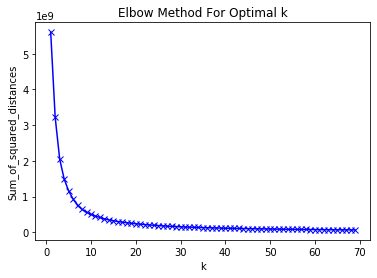

In [36]:
import matplotlib.pyplot as plt
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

In [37]:
number_of_clusters = 10
kmeans = KMeans(n_clusters=number_of_clusters, random_state=0).fit(good_xys)
cluster_centers = [xy_to_lonlat(cc[0], cc[1]) for cc in kmeans.cluster_centers_]

In [38]:
map_toronto = folium.Map(location=roi_center, zoom_start=14)
folium.TileLayer('cartodbpositron').add_to(map_toronto)
HeatMap(restaurant_latlons).add_to(map_toronto)
folium.Circle(roi_center, radius=2500, color='white', fill=True, fill_opacity=0.4).add_to(map_toronto)
folium.Marker((toronto_latitude_center, toronto_longitude_center)).add_to(map_toronto)
for lon, lat in cluster_centers:
    folium.Circle([lat, lon], radius=500, color='green', fill=True, fill_opacity=0.25).add_to(map_toronto) 
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_toronto)
folium.GeoJson(toronto_boroughs, style_function=boroughs_style, name='geojson').add_to(map_toronto)
map_toronto

Not bad - our clusters represent groupings of most of the candidate locations and cluster centers are placed nicely in the middle of the zones 'rich' with location candidates.

Addresses of those cluster centers will be a good starting point for exploring the neighborhoods to find the best possible location based on neighborhood specifics.

Let's see those zones on a city map without heatmap, using shaded areas to indicate our clusters:

In [41]:
map_toronto = folium.Map(location=roi_center, zoom_start=14)
folium.Marker((toronto_latitude_center, toronto_longitude_center)).add_to(map_toronto)
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.Circle([lat, lon], radius=250, color='#00000000', fill=True, fill_color='#0066ff', fill_opacity=0.07).add_to(map_toronto)
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_toronto)
for lon, lat in cluster_centers:
    folium.Circle([lat, lon], radius=500, color='green', fill=False).add_to(map_toronto) 
folium.GeoJson(toronto_boroughs, style_function=boroughs_style, name='geojson').add_to(map_toronto)
map_toronto

Let's zoom in on candidate areas in **KBridle Path-Sunnybrook**:

In [40]:
map_toronto = folium.Map(location=[43.72793962613892, -79.3781377920526], zoom_start=15)
folium.Marker((toronto_latitude_center, toronto_longitude_center)).add_to(map_toronto)
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.Circle([lat, lon], radius=250, color='#0000ff00', fill=True, fill_color='#0066ff', fill_opacity=0.07).add_to(map_toronto)
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_toronto)
for lon, lat in cluster_centers:
    folium.Circle([lat, lon], radius=500, color='green', fill=False).add_to(map_toronto)
folium.GeoJson(toronto_boroughs, style_function=boroughs_style, name='geojson').add_to(map_toronto)
map_toronto

...in candidate areas in **Leaside**:

In [42]:
map_toronto = folium.Map(location=[43.7, -79.366667], zoom_start=15)
folium.Marker((toronto_latitude_center, toronto_longitude_center)).add_to(map_toronto)
for lon, lat in cluster_centers:
    folium.Circle([lat, lon], radius=500, color='green', fill=False).add_to(map_toronto) 
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.Circle([lat, lon], radius=250, color='#0000ff00', fill=True, fill_color='#0066ff', fill_opacity=0.07).add_to(map_toronto)
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_toronto)
folium.GeoJson(toronto_boroughs, style_function=boroughs_style, name='geojson').add_to(map_toronto)
map_toronto

...and in candidate areas in **Rosedale-Moore Park**:

In [43]:
map_toronto = folium.Map(location=[43.693486332504726, -79.38272774233984], zoom_start=15)
folium.Marker((toronto_latitude_center, toronto_longitude_center)).add_to(map_toronto)
for lon, lat in cluster_centers:
    folium.Circle([lat, lon], radius=500, color='green', fill=False).add_to(map_toronto) 
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.Circle([lat, lon], radius=250, color='#0000ff00', fill=True, fill_color='#0066ff', fill_opacity=0.07).add_to(map_toronto)
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.CircleMarker([lat, lon], radius=2, color='blue', fill=True, fill_color='blue', fill_opacity=1).add_to(map_toronto)
folium.GeoJson(toronto_boroughs, style_function=boroughs_style, name='geojson').add_to(map_toronto)
map_toronto

Finaly, let's **reverse geocode those candidate area centers to get the addresses** which can be presented to stakeholders.

In [44]:
candidate_area_addresses = []
print('==============================================================')
print('Addresses of centers of areas recommended for further analysis')
print('==============================================================\n')
for lon, lat in cluster_centers:
    addr = get_address(lat, lon)
    candidate_area_addresses.append(addr)    
    x, y = lonlat_to_xy(lon, lat)
    d = calc_xy_distance(x, y, toronto_longitude_center_x, toronto_latitude_center_y)
    print('{}{} => {:.1f}km from Toronto Center'.format(addr, ' '*(50-len(addr)), d/1000))
    

Addresses of centers of areas recommended for further analysis

Toronto Tennis City, 185, Balliol Street, Chaplin Estates, Toronto—St. Paul's, Old Toronto, Toronto, Golden Horseshoe, Ontario, M4S 1C2, Canada => 1.5km from Toronto Center
21, Burkebrook Place, Don Valley West, North York, Toronto, Golden Horseshoe, Ontario, M4G 1R8, Canada => 3.3km from Toronto Center
255, Erskine Avenue, Sherwood Park, Don Valley West, Old Toronto, Toronto, Golden Horseshoe, Ontario, M4P 2L7, Canada => 1.6km from Toronto Center
62, McRae Drive, Leaside, Don Valley West, East York, Toronto, Golden Horseshoe, Ontario, M4G 3A1, Canada => 3.3km from Toronto Center
37, Parklea Drive, Leaside Business Park, Don Valley West, East York, Toronto, Golden Horseshoe, Ontario, M4G 4E4, Canada => 3.4km from Toronto Center
1184, Mount Pleasant Road, Sherwood Park, Don Valley West, Old Toronto, Toronto, Golden Horseshoe, Ontario, M4P 2M5, Canada => 2.1km from Toronto Center
528, Hillsdale Avenue East, Davisville, Don V

This concludes our analysis. We have created 10 addresses representing centers of zones containing locations with low number of restaurants and no Italian restaurants nearby, all zones being fairly close to city center (all less than 4km from Toronto Center, and about half of those less than 2km from Toronto Center). Although zones are shown on map with a radius of ~500 meters (green circles), their shape is actually very irregular and their centers/addresses should be considered only as a starting point for exploring area neighborhoods in search for potential restaurant locations. Most of the zones are located in Bridle Path-Sunnybrook,  Leaside and Rosedale-Moore Park boroughs.

In [45]:
map_toronto = folium.Map(location=roi_center, zoom_start=14)
folium.Circle((toronto_latitude_center, toronto_longitude_center), radius=50, color='red', fill=True, fill_color='red', fill_opacity=1).add_to(map_toronto)
for lonlat, addr in zip(cluster_centers, candidate_area_addresses):
    pp = folium.Html(addr)
    popup = folium.Popup(pp, max_width=2650)
    folium.Marker([lonlat[1], lonlat[0]], popup=popup).add_to(map_toronto) 
for lat, lon in zip(good_latitudes, good_longitudes):
    folium.Circle([lat, lon], radius=250, color='#0000ff00', fill=True, fill_color='#0066ff', fill_opacity=0.05).add_to(map_toronto)
#folium.GeoJson(toronto_boroughs, style_function=boroughs_style, name='geojson').add_to(map_toronto)
map_toronto

## Results and Discussion <a name="results"></a>

Our analysis shows that although there is a great number of restaurants in Toronto (~2000 in our initial area of interest which was 12x12km around Toronto Center), there are pockets of low restaurant density fairly close to city center. Highest concentration of restaurants was detected sud and sud-west from Toronto Center, so we focused our attention to areas nord, nord-east, east, nord-east e sud-east from Toronto Center, corresponding to boroughs Bridle Path-Sunnybrook, Leaside and Rosedale-Moore Park.

After directing our attention to this more narrow area of interest (covering approx. 5x5km south-east from Toronto Center) we first created a dense grid of location candidates (spaced 100m appart); those locations were then filtered so that those with more than two restaurants in radius of 250m and those with an Italian restaurant closer than 400m were removed.

Those location candidates were then clustered to create zones of interest which contain greatest number of location candidates. Addresses of centers of those zones were also generated using reverse geocoding to be used as markers/starting points for more detailed local analysis based on other factors.

Result of all this is 10 zones containing largest number of potential new restaurant locations based on number of and distance to existing venues - both restaurants in general and Italian restaurants particularly. This, of course, does not imply that those zones are actually optimal locations for a new restaurant! Purpose of this analysis was to only provide info on areas close to Toronto center but not crowded with existing restaurants (particularly Italian) - it is entirely possible that there is a very good reason for small number of restaurants in any of those areas, reasons which would make them unsuitable for a new restaurant regardless of lack of competition in the area. Recommended zones should therefore be considered only as a starting point for more detailed analysis which could eventually result in location which has not only no nearby competition but also other factors taken into account and all other relevant conditions met.

## Conclusion <a name="conclusion"></a>

Purpose of this project was to identify Toronto areas close to center with low number of restaurants (particularly Italian restaurants) in order to aid stakeholders in narrowing down the search for optimal location for a new Italian restaurant. By calculating restaurant density distribution from Foursquare data we have first identified general boroughs that justify further analysis (Bridle Path-Sunnybrook, Leaside and Rosedale-Moore Park), and then generated extensive collection of locations which satisfy some basic requirements regarding existing nearby restaurants. Clustering of those locations was then performed in order to create major zones of interest (containing greatest number of potential locations) and addresses of those zone centers were created to be used as starting points for final exploration by stakeholders.

Final decission on optimal restaurant location will be made by stakeholders based on specific characteristics of neighborhoods and locations in every recommended zone, taking into consideration additional factors like attractiveness of each location (proximity to park or water), levels of noise / proximity to major roads, real estate availability, prices, social and economic dynamics of every neighborhood etc.